In [1]:
isodir = '/orange/adamginsburg/ice/iso/library/swsatlas/'

In [2]:
import pyspeckit

In [12]:
from astropy.io import fits
from astropy import units as u
fh = fits.open(f'{isodir}/30601207_sws.fit')

In [15]:
fh[0].header['OBJECT']

'IRAS15559-5546'

In [21]:
fh[0].header

SIMPLE  =                    T / Written by IDL:  Wed Apr  9 10:16:02 2003      
BITPIX  =                  -32 / Number of bits per data pixel                  
NAXIS   =                    2 / Number of data axes                            
NAXIS1  =                    4 /                                                
NAXIS2  =                12318 /                                                
NSEG    =                   12 / Number of spectral segments                    
NSEG01  =                  482 / Length of segment  1                           
NSEG02  =                  630 / Length of segment  2                           
NSEG03  =                  750 / Length of segment  3                           
NSEG04  =                  560 / Length of segment  4                           
NSEG05  =                 1220 / Length of segment  5                           
NSEG06  =                  850 / Length of segment  6                           
NSEG07  =                 27

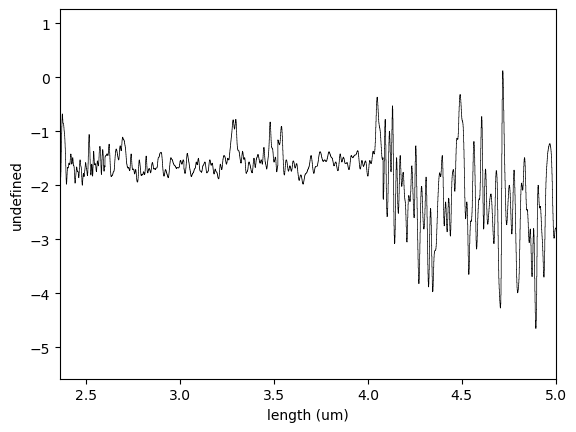

In [14]:
sp = pyspeckit.Spectrum(xarr=fh[0].data[:,0]*u.um, data=fh[0].data[:,1])
sp.plotter(xmax=5)

In [16]:
from icemodels import fluxes_in_filters

from astroquery.svo_fps import SvoFps
jfilts = SvoFps.get_filter_list('JWST')
jfilts.add_index('filterID')

# filter_ids = ['JWST/NIRCam.F410M', 'JWST/NIRCam.F466N', 'JWST/NIRCam.F356W', 
#              'JWST/NIRCam.F444W', 'JWST/NIRCam.F405N']
filter_ids = [fid for fid in jfilts['filterID'] if fid.startswith('JWST/NIRCam')]
filter_data = {fid: float(jfilts.loc[fid]['ZeroPoint']) for fid in filter_ids}
transdata = {fid: SvoFps.get_transmission_data(fid) for fid in filter_ids}


In [23]:
from tqdm.auto import tqdm
import glob
import numpy as np

In [26]:
iso_data = []
for fn in tqdm(glob.glob(f'{isodir}/*sws.fit')):
    fh = fits.open(fn)
    iso_flxd = fluxes_in_filters(fh[0].data[:,0]*u.um, fh[0].data[:,1]*u.Jy, filterids=filter_ids, transdata=transdata)
    iso_mags = {key: -2.5*np.log10(iso_flxd[key].to(u.Jy).value / filter_data[key]) for key in iso_flxd}
    iso_mags['Object'] = fh[0].header['OBJECT']
    iso_data.append(iso_mags)

  0%|          | 0/1262 [00:00<?, ?it/s]

invalid value encountered in log10
divide by zero encountered in log10


In [28]:
from astropy.table import Table

In [30]:
Table(iso_data).write(f'{isodir}/iso_spectra_as_fluxes.fits')

In [31]:
tbl = Table(iso_data)

In [33]:
import pylab as pl

(-2.0, 5.0)

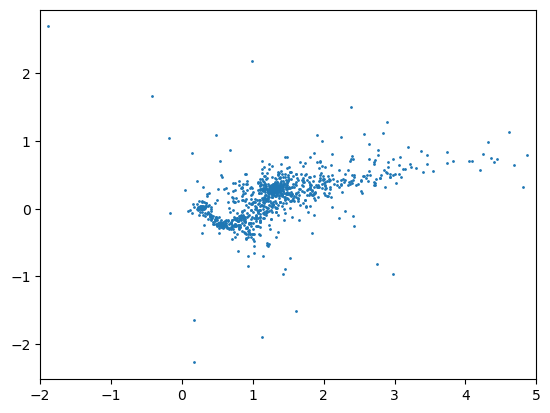

In [37]:
pl.scatter(tbl['JWST/NIRCam.F212N'] - tbl['JWST/NIRCam.F410M'],
           tbl['JWST/NIRCam.F410M'] - tbl['JWST/NIRCam.F466N'],
           s=1
          )
pl.xlim(-2, 5)

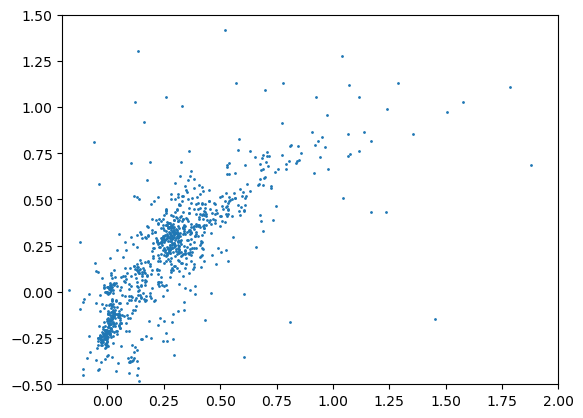

In [42]:
pl.scatter(tbl['JWST/NIRCam.F356W'] - tbl['JWST/NIRCam.F410M'],
           tbl['JWST/NIRCam.F410M'] - tbl['JWST/NIRCam.F466N'],
           s=1
          )
pl.xlim(-0.2, 2)
pl.ylim(-0.5, 1.5);

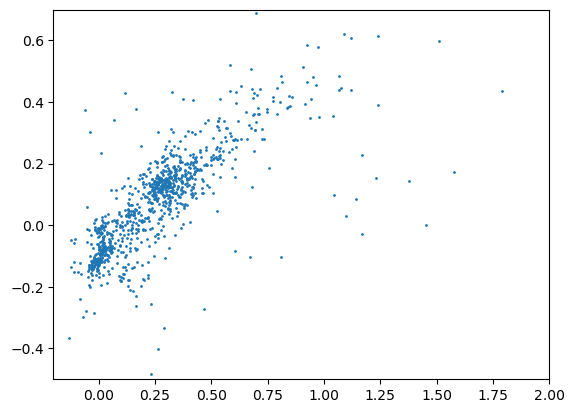

In [41]:
pl.scatter(tbl['JWST/NIRCam.F356W'] - tbl['JWST/NIRCam.F410M'],
           tbl['JWST/NIRCam.F410M'] - tbl['JWST/NIRCam.F444W'],
           s=1
          )
pl.xlim(-0.2, 2)
pl.ylim(-0.5, 0.7);

In [44]:
fh = fits.open('/orange/adamginsburg/jwst/spectra/mastDownload/JWST/jw01960-o015_t015_nirspec_prism-clear/jw01960-o015_t015_nirspec_prism-clear_x1d.fits')

In [48]:
tb = Table.read('/orange/adamginsburg/jwst/spectra/mastDownload/JWST/jw01960-o015_t015_nirspec_prism-clear/jw01960-o015_t015_nirspec_prism-clear_x1d.fits', hdu=1)
tb

WAVELENGTH,FLUX,FLUX_ERROR,FLUX_VAR_POISSON,FLUX_VAR_RNOISE,FLUX_VAR_FLAT,SURF_BRIGHT,SB_ERROR,SB_VAR_POISSON,SB_VAR_RNOISE,SB_VAR_FLAT,DQ,BACKGROUND,BKGD_ERROR,BKGD_VAR_POISSON,BKGD_VAR_RNOISE,BKGD_VAR_FLAT,NPIXELS
um,Jy,Jy,Jy2,Jy2,Jy2,MJy / sr,MJy / sr,(MJy/sr)^2,(MJy/sr)^2,(MJy/sr)^2,,MJy / sr,MJy / sr,(MJy/sr)^2,(MJy/sr)^2,(MJy/sr)^2,
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,uint32,float64,float64,float64,float64,float64,float64
0.6025000237859786,-0.00013442357222603064,2.4431084789726754e-05,0.0,0.0,0.0,-0.40561548666500136,0.0737194093464209,0.0,0.0,0.0,0,-0.3637629272693736,0.07052231401873585,0.0,0.0,0.0,1410.0
0.6075000236742198,-9.205710123837877e-05,1.4348599789474562e-05,0.0,0.0,0.0,-0.27738361722669663,0.04323475819031519,0.0,0.0,0.0,0,-0.2895091228076913,0.04109851231980869,0.0,0.0,0.0,1412.0
0.6125000235624611,-4.444530968025984e-05,1.0432800538381015e-05,0.0,0.0,0.0,-0.13392123586367563,0.03143579270052321,0.0,0.0,0.0,0,-0.09962350241082549,0.03015346209901919,0.0,0.0,0.0,1412.0
0.6175000234507024,3.699057902015829e-06,8.170414764007253e-06,0.0,0.0,0.0,0.011153786426012733,0.024636289483334545,0.0,0.0,0.0,0,0.015669721345332534,0.02404181199296891,0.0,0.0,0.0,1411.0
0.6225000233389437,2.097738428858297e-05,7.046666917791053e-06,0.0,0.0,0.0,0.06329806444114602,0.021262916792747576,0.0,0.0,0.0,0,0.10323613084325628,0.019865732785016663,0.0,0.0,0.0,1410.0
0.627500023227185,5.546069915044594e-05,6.109895407010563e-06,0.0,0.0,0.0,0.16758721888727218,0.018462449890424525,0.0,0.0,0.0,0,0.17494455507508272,0.017497226839766615,0.0,0.0,0.0,1408.0
0.6325000231154263,5.804623713866171e-05,5.485266478084537e-06,0.0,0.0,0.0,0.17527552928716142,0.01656322670719733,0.0,0.0,0.0,0,0.21084337680283374,0.0154167299184973,0.0,0.0,0.0,1409.0
0.6375000230036676,8.022409272096555e-05,4.920468234731668e-06,0.0,0.0,0.0,0.24207163871941323,0.014847233149662442,0.0,0.0,0.0,0,0.2550452699444545,0.013748529432113946,0.0,0.0,0.0,1410.0


# NIRSPEC

  0%|          | 0/485 [00:00<?, ?it/s]

invalid value encountered in subtract
invalid value encountered in subtract
invalid value encountered in subtract


  0%|          | 0/485 [00:00<?, ?it/s]

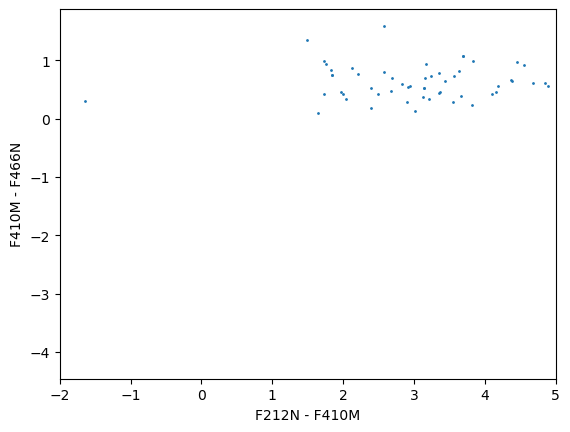

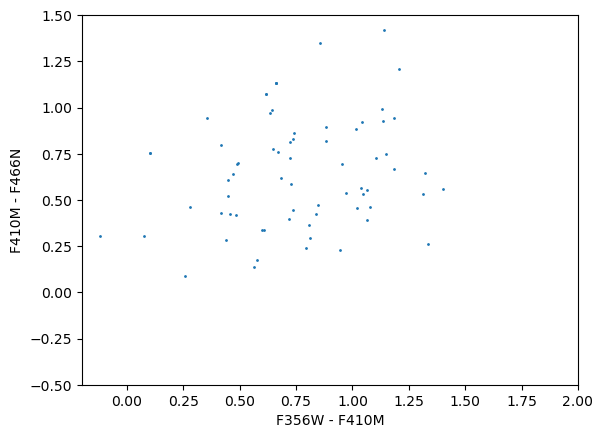

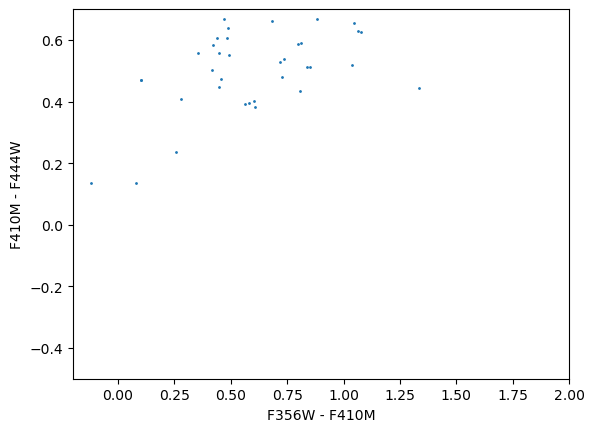

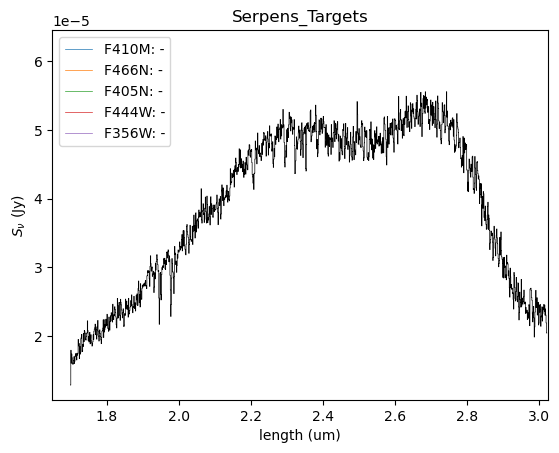

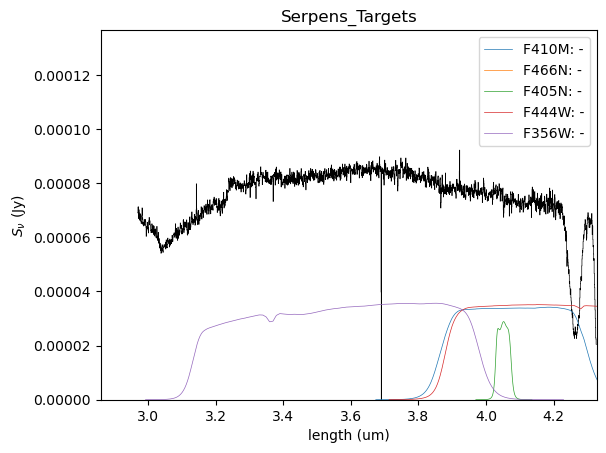

...

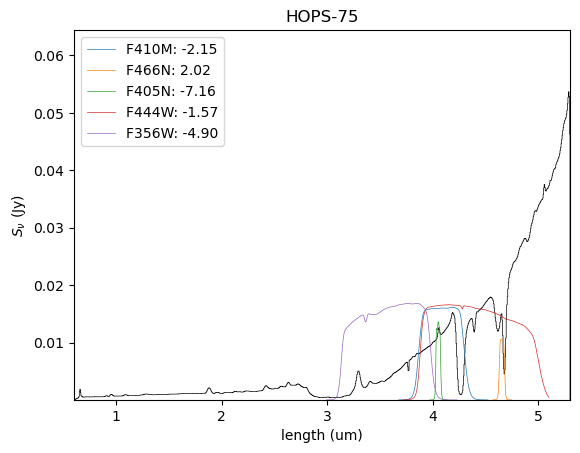

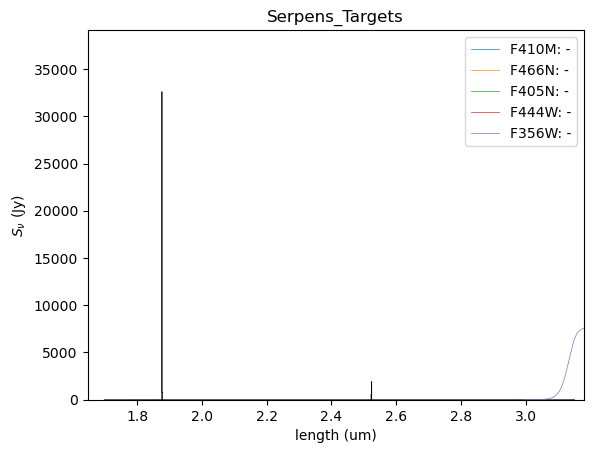

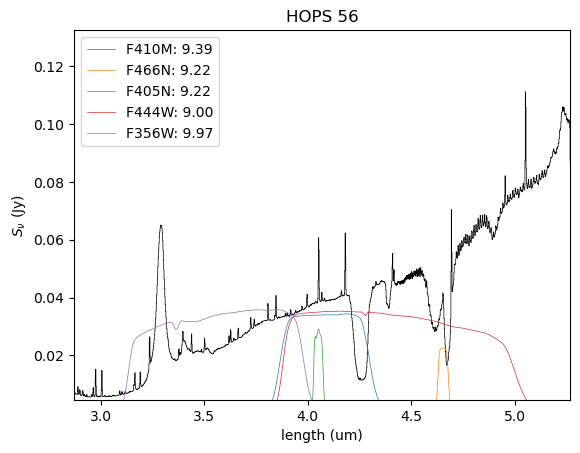

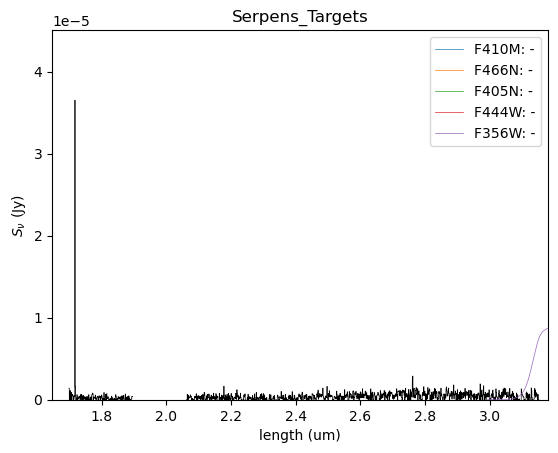

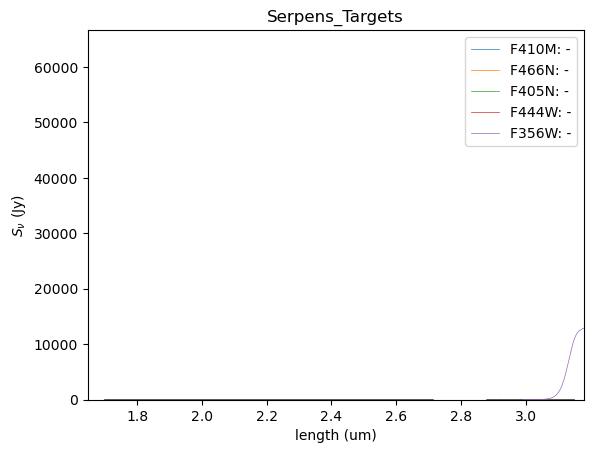

In [1]:
%run /orange/adamginsburg/jwst/brick/analysis/JWST_Archive_Spectra.py

  0%|          | 0/104 [00:00<?, ?it/s]

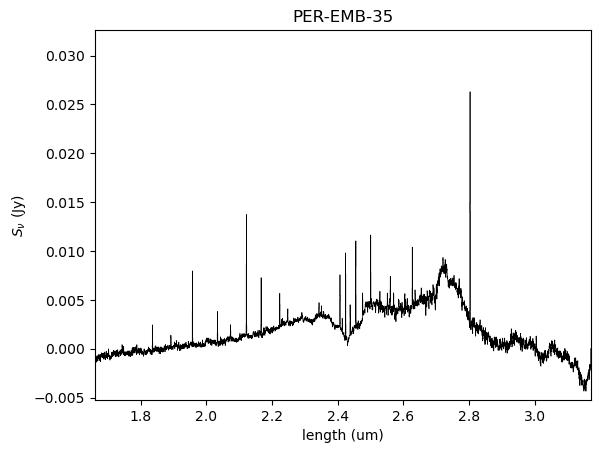

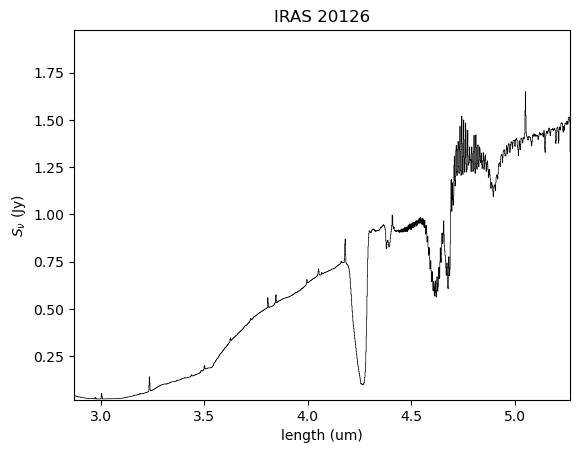

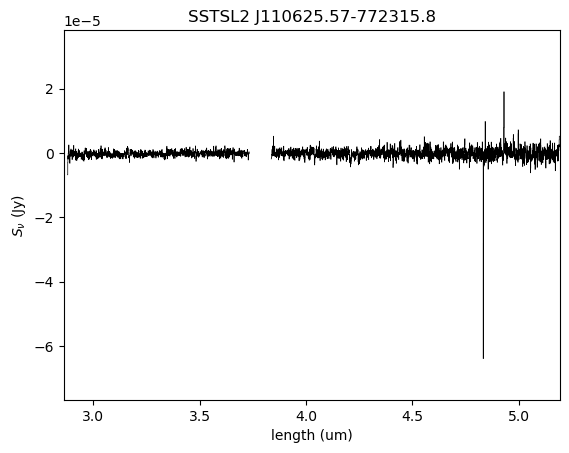

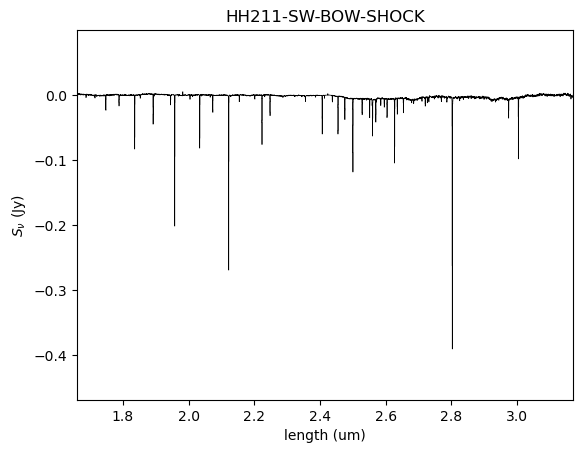

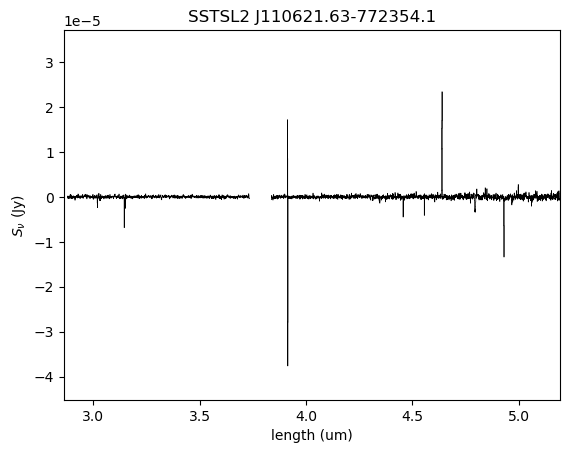

...

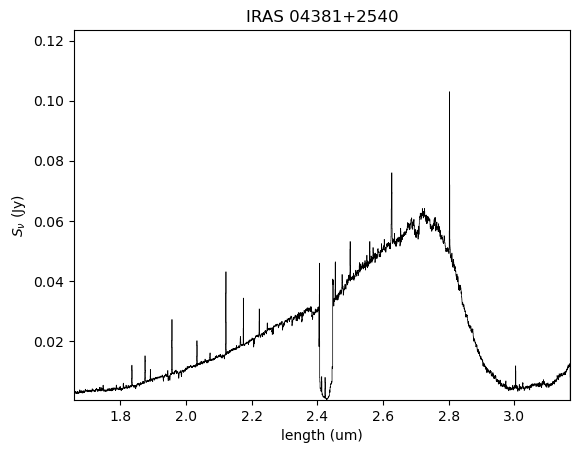

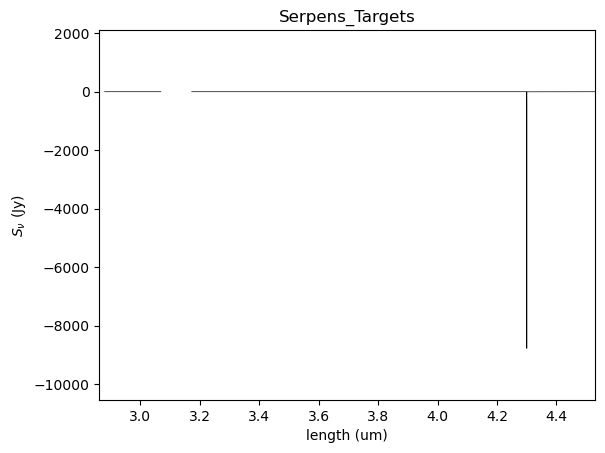

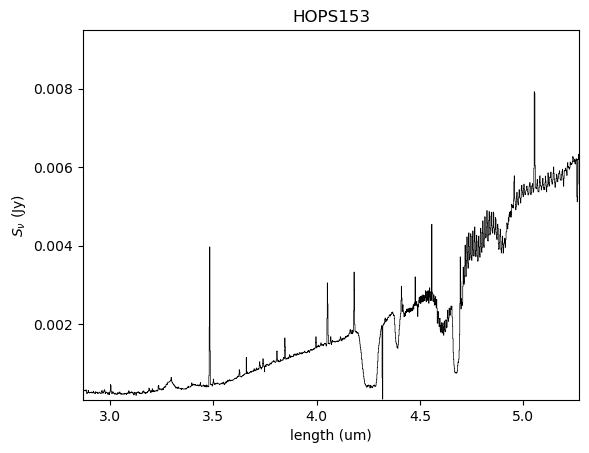

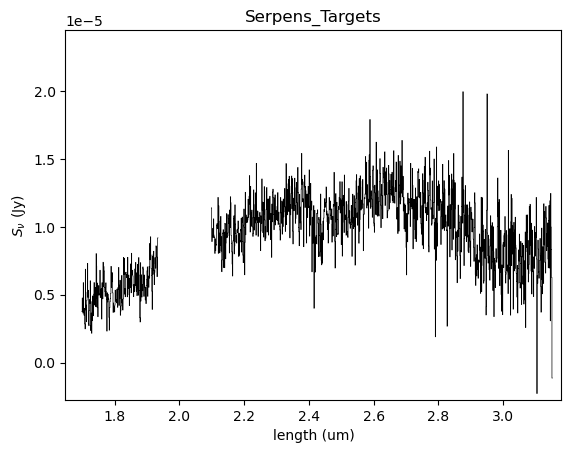

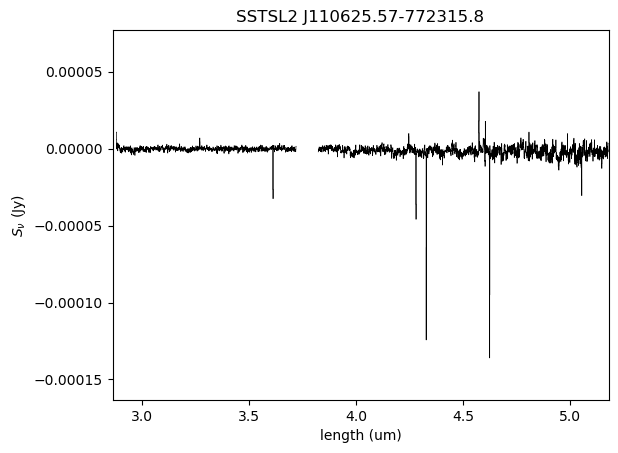

In [90]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    for fn in tqdm(glob.glob(f'{nirspec_dir}/jw*/*x1d.fits')):
        fh = fits.open(fn)
        spectable = Table.read(fn, hdu=1)
        sp = pyspeckit.Spectrum(xarr=spectable['WAVELENGTH'].quantity,
                                data=spectable['FLUX'].quantity,
                                header=fh[0].header
                               )
        obj = fh[0].header["TARGNAME"]
        if obj == '':
            obj = fh[0].header['TARGPROP']
        if obj is None or obj == '':
            obj = os.path.basename(fn).split('x1d')[0]
        sp.specname = obj
        sp.plotter()

In [85]:
fh[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  
DATE    = '2025-01-12T07:29:47.994' / UTC date file created                     
ORIGIN  = 'STSCI   '           / Organization responsible for creating file     
TIMESYS = 'UTC     '           / principal time system for time-related keywords
TIMEUNIT= 's       '           / Default unit applicable to all time values     
FILENAME= 'jw01309-o022_s000000024_nirspec_f290lp-g395h-s1600a1-allslits_x1d.f&'
CONTINUE  'its&'                                                                
CONTINUE  '' / Name of the file                                                 
SDP_VER = '2024_3a '           / Data processing (DP) Software Version          
PRD_VER = 'PRDOPSSOC-068'   

In [60]:
tbl.add_index('Object')
tbl.loc['HOPS153']

JWST/NIRCam.F070W,JWST/NIRCam.F090W,JWST/NIRCam.F115W,JWST/NIRCam.F140M,JWST/NIRCam.F150W,JWST/NIRCam.F162M,JWST/NIRCam.F164N,JWST/NIRCam.F150W2,JWST/NIRCam.F182M,JWST/NIRCam.F187N,JWST/NIRCam.F200W,JWST/NIRCam.F210M,JWST/NIRCam.F212N,JWST/NIRCam.F250M,JWST/NIRCam.F277W,JWST/NIRCam.F300M,JWST/NIRCam.F323N,JWST/NIRCam.F322W2,JWST/NIRCam.F335M,JWST/NIRCam.F356W,JWST/NIRCam.F360M,JWST/NIRCam.F405N,JWST/NIRCam.F410M,JWST/NIRCam.F430M,JWST/NIRCam.F444W,JWST/NIRCam.F460M,JWST/NIRCam.F466N,JWST/NIRCam.F470N,JWST/NIRCam.F480M,Object
float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,bytes27
17.409136216430994,17.18157936536004,16.908746218876274,16.57889887488907,16.475934676567306,16.328292311069433,16.287789464953505,16.455253281244676,16.1206312300102,16.05427275497014,16.00223934387038,15.897584727623585,15.876550968672243,15.561040459238221,15.442519978912275,15.365106391180063,14.939907104832988,14.449810778614783,14.564419298702155,13.93494478605434,13.884489255102432,12.747313396113029,12.961823484398241,12.819685147820788,12.234852948933723,12.068000502637961,12.424516022862079,11.878313943380153,11.481712480214071,HOPS153


<Figure size 960x720 with 0 Axes>

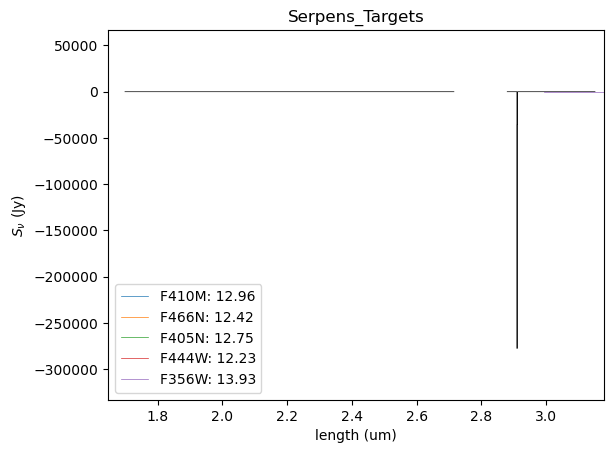

In [94]:
pl.figure(dpi=150)
sp.plotter()
for key in ['JWST/NIRCam.F410M', 'JWST/NIRCam.F466N', 'JWST/NIRCam.F405N', 'JWST/NIRCam.F444W', 'JWST/NIRCam.F356W']:
    pl.plot(transdata[key]['Wavelength']/1e4, transdata[key]['Transmission'] * 0.008, linewidth=0.5,
            label=f"{key[-5:]}: {tbl.loc['HOPS153'][key]:0.2f}"
           )
pl.legend(loc='best');

In [63]:
transdata

{'JWST/NIRCam.F070W': <Table length=201>
 Wavelength Transmission
     AA                 
  float64     float64   
 ---------- ------------
     6031.5  0.000309961
     6041.5   0.00123754
     6051.5   0.00409764
     6061.5     0.010342
     6071.5    0.0207281
     6081.5    0.0345091
     6091.5    0.0494549
     6101.5    0.0632327
     6111.5    0.0743233
        ...          ...
     7951.5   0.00106776
     7961.5  0.000784746
     7971.5  0.000581088
     7981.5  0.000432432
     7991.5  0.000324602
     8001.5  0.000246103
     8011.5  0.000187665
     8021.5  0.000143742
     8031.5  0.000111208,
 'JWST/NIRCam.F090W': <Table length=253>
 Wavelength Transmission
     AA                 
  float64     float64   
 ---------- ------------
     7835.5  0.000131259
     7845.5  0.000226688
     7855.5  0.000439803
     7865.5  0.000952515
     7875.5   0.00215415
     7885.5   0.00505523
     7895.5     0.011825
     7905.5     0.024768
     7915.5    0.0461123
        ...      